# MetLife ML Engineering Challenge

### Lucas Argento

## About the Challenge

We want to predict the medical insurance costs incurred by our clients. To achieve that, we have the following variables to work with:

- Dataset Variables
> - Age: The insured person's age.
> - Sex: Gender (male or female) of the insured.
> - BMI (Body Mass Index): A measure of body fat based on height and weight. Children: The number of dependents covered.
> - Smoker: Whether the insured is a smoker (yes or no).
> - Region: The geographic area of coverage.

- Variable to Predict
> - Charges: The medical insurance costs incurred by the insured person.

## 1) Imports and Data Loading

In [8]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

In [4]:
df = pd.read_csv("Dataset/dataset.csv")

#### Initial look at the data

  0%|                                                                                                         …

/Users/lucasargento/miniforge3/envs/MetLife/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
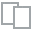
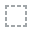
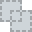
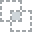
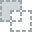
...
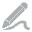
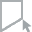
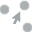
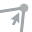
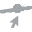

In [7]:
from dataprep.eda import create_report
create_report(df)

In [ ]:
df.shape

#### Important note: 

> The dataset doesn't present any null values, but in a real case scenario real data probably would, forcing us to do some data cleaning such as null treatment and outlier analysis.

> I'm also asuming that all variables in the dataset have somehow some predictive power over the target variable. A deeper EDA should be performed to better understand the impact of the different features on the variable to predict, alongside with some Feature Engineering to add more predictive power to our models with a data-centric approach.


## 2) Modelling Approach

Since the target we want to predict is a continous and numerical variable, the best way to attack this task is to model the situation as a **regression problem**. 

We will train and test several regression models and choose the best performing one to predict in production. The models we are going to evaluate are:

- Multiple Linear Regression
- Polinomial Regression
- Simple Decision Tree Regressor
- Random Forest
- Gradient Boosting
- Simple Neural Network (MLP)


In [9]:
df.head()

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


#### Quick Exploration

In [10]:
import plotly.express as px

def plot(column):
    fig = px.scatter(df, x=column, y='charges')
    fig.show()

def plot3d(column1, column2):
    fig = px.scatter_3d(df, x=column1, y=column2, z='charges')
    fig.show()

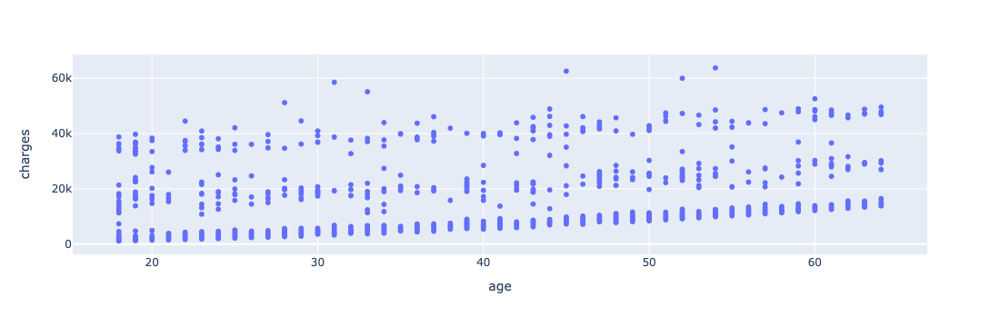

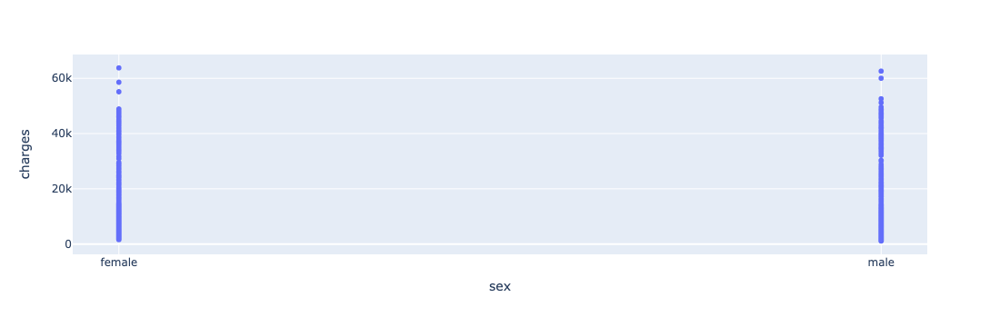

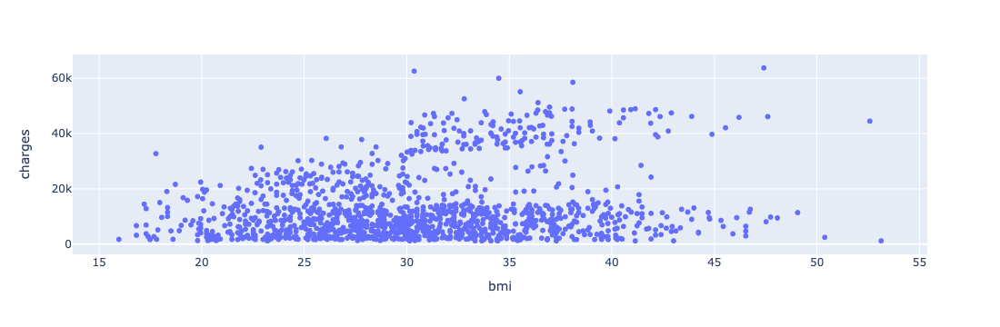

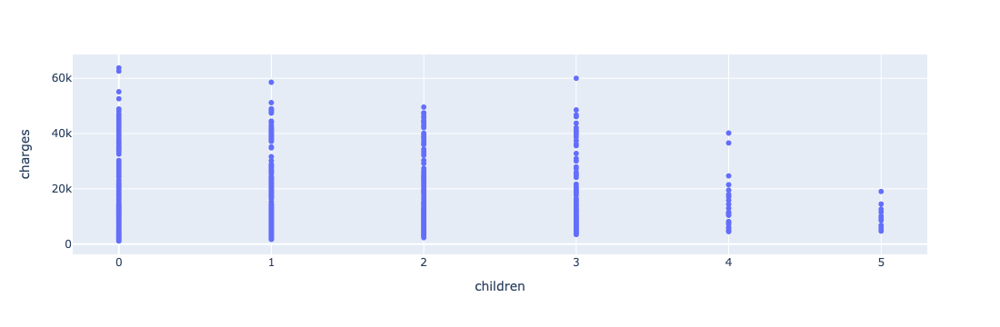

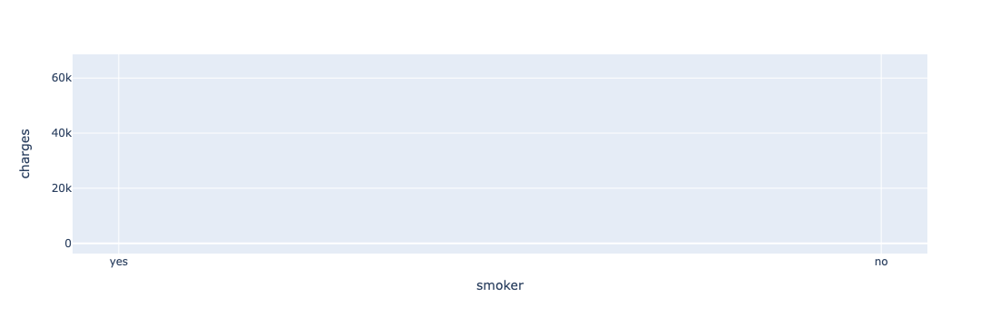

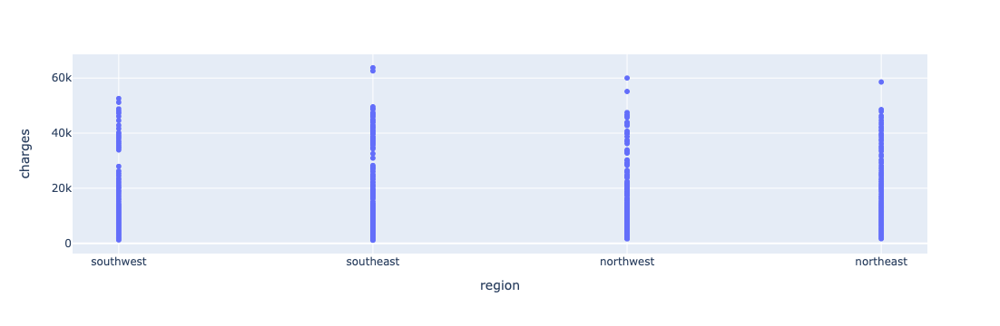

In [11]:
varbs = ['age', 'sex', 'bmi', 'children', 'smoker', 'region']

for var in varbs:
    plot(var)
    

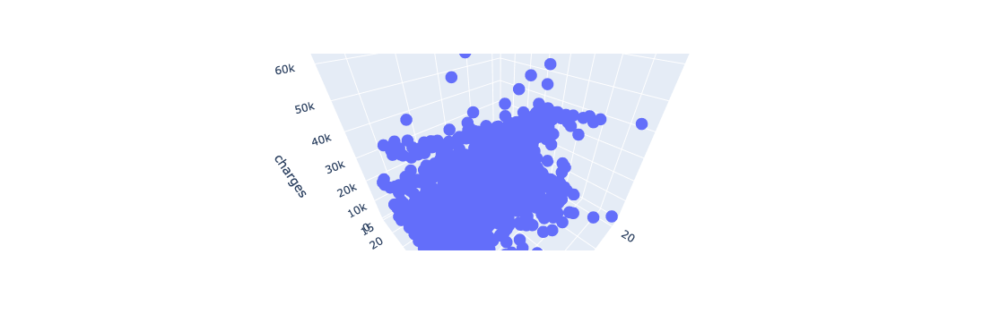

In [12]:
plot3d("age","bmi")

## 3) Preprocesing

We are going to encode categorical variables using One-Hot Encoding. This step can be done before splitting the dataset since it is not adding any aditional information about the data such as the mean or stdev that are added when scalling. 

In [13]:
df_encoded = pd.get_dummies(df, columns=['sex', "smoker", "region", "children"])

In [14]:
df_encoded.head()

,age,bmi,charges,sex_female,sex_male,smoker_no,smoker_yes,region_northeast,region_northwest,region_southeast,region_southwest,children_0,children_1,children_2,children_3,children_4,children_5
0,19,27.900,16884.92400,1,0,0,1,0,0,0,1,1,0,0,0,0,0
1,18,33.770,1725.55230,0,1,1,0,0,0,1,0,0,1,0,0,0,0
2,28,33.000,4449.46200,0,1,1,0,0,0,1,0,0,0,0,1,0,0
3,33,22.705,21984.47061,0,1,1,0,0,1,0,0,1,0,0,0,0,0
4,32,28.880,3866.85520,0,1,1,0,0,1,0,0,1,0,0,0,0,0


## 4) Train-Test Split:

Dataset split into a training set and a testing set for the models to be trained and evaluated later.

In [15]:
y = df_encoded.charges
X = df_encoded.drop("charges", axis = 1, inplace = False)

In [16]:
# Step 1: Split the data into a training and testing set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [17]:
X_train.shape

(1070, 16)

In [18]:
X_test.shape

(268, 16)


## 5) Feature Scaling:

Standardize the numerical features to ensure that all features have the same scale and that one does not weight more than the other on algorithms suchs as linear regressions. THIS SHOULD ALWAYS BE DONE AFTER SPLITTING our dataset to avoid data leakage.

In [19]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [20]:
X_train.shape

(1070, 16)

In [21]:
X_test.shape

(268, 16)

## 6) Model Training and Hyperparameter Tunning

Several models will be trained and and optimizes over some of their hyperparameters. 

We will evaluate model performance based on several metrics commonly used for regression problems. Among them: MSE, RMSE, MAE and R2. 

The model that achives the best value for this metrics is the one we will use to predict charge values in production.
We will be performing a GridSearch with cross validation folds to retrieve the best hyperparameters and to help the model generalize better.

In [22]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

maes = []
r2 = []
model_instances = []

In [23]:
models = {"Linear Regression":0,
         "Polinomial Regression": 0,
          "Simple DT": 0,
          "Random Forest": 0,
          "Gradient Boosting":0,
          "MLP": 0,
         }

#### 6.1) Linear Regression

In [24]:
model = LinearRegression()

linear_grid_search = GridSearchCV(
    model,
    param_grid={},
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

linear_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=LinearRegression(), n_jobs=-1, param_grid={},
             scoring='neg_mean_squared_error')

In [25]:
best_linear = linear_grid_search.best_estimator_
model_instances.append(best_linear)

In [26]:
y_pred_train = best_linear.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 37177349.70486657


In [27]:
y_pred = best_linear.predict(X_test)

In [28]:
mse = mean_squared_error(y_test, y_pred)
models["Linear Regression"] = mse
print(f"Mean Squared Error: {round(mse,2)}")
print(f"Root Mean Squared Error: {round(np.sqrt(mse),2)}")
print(f"MAE: {round(mean_absolute_error(y_test, y_pred),2)}")

Mean Squared Error: 33641689.33
Root Mean Squared Error: 5800.15
MAE: 4146.09


In [29]:
test = pd.Series(y_test)
test.describe()

count      268.000000
mean     12968.317063
std      12483.196202
min       1131.506600
25%       4288.744850
50%       8487.880300
75%      16367.829375
max      63770.428010
Name: charges, dtype: float64

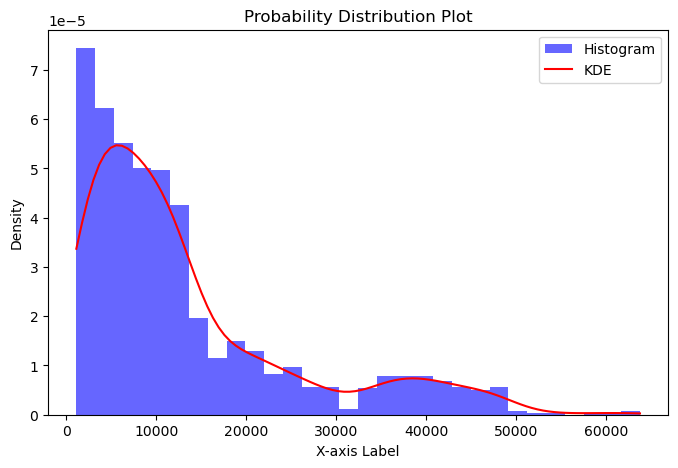

In [30]:
import matplotlib.pyplot as plt
import scipy.stats as stats


plt.figure(figsize=(8, 5))
plt.hist(df.charges, bins=30, density=True, alpha=0.6, color='blue', label='Histogram')
plt.title('Probability Distribution Plot')
plt.xlabel('X-axis Label')
plt.ylabel('Density')
plt.legend()

data = df.charges
# Add a kernel density estimate (KDE)
kde = stats.gaussian_kde(data)
x = np.linspace(data.min(), data.max(), 100)
plt.plot(x, kde(x), 'r', label='KDE')
plt.legend()

plt.show()

In [31]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

#### 6.2) Polinomial Regression

In [32]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline


polynomial_regressor = make_pipeline(PolynomialFeatures(), LinearRegression())

poly_param_grid = {
    'polynomialfeatures__degree': [1, 2, 3, 4]
}

poly_grid_search = GridSearchCV(
    polynomial_regressor,
    param_grid=poly_param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

poly_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('polynomialfeatures',
                                        PolynomialFeatures()),
                                       ('linearregression',
                                        LinearRegression())]),
             n_jobs=-1, param_grid={'polynomialfeatures__degree': [1, 2, 3, 4]},
             scoring='neg_mean_squared_error')

In [33]:
best_poly_model = poly_grid_search.best_estimator_
model_instances.append(best_poly_model)

In [34]:
y_pred_train = best_poly_model.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 37096089.82059017


In [35]:
y_pred = best_poly_model.predict(X_test)

In [36]:
mse_2 = mean_squared_error(y_test, y_pred)
models["Polinomial Regression"] = mse
print(f"Mean Squared Error: {mse_2}")

Mean Squared Error: 33797886.74941285


In [37]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

#### 6.3) Simple Decision Tree Regressor

In [38]:
from sklearn.tree import DecisionTreeRegressor

In [39]:
dt_param_grid = {
    'max_depth': [None, 3, 5, 7,10,20],
    'min_samples_split': [2, 5, 10]
}

dt_grid_search = GridSearchCV(
    DecisionTreeRegressor(),
    param_grid=dt_param_grid,
    cv=5,  
    scoring='neg_mean_squared_error', 
    n_jobs=-1 
)

In [40]:
dt_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'max_depth': [None, 3, 5, 7, 10, 20],
                         'min_samples_split': [2, 5, 10]},
             scoring='neg_mean_squared_error')

In [41]:
best_dt_regressor  = dt_grid_search.best_estimator_
model_instances.append(best_dt_regressor)

In [42]:
y_pred_train = best_dt_regressor.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 21120357.016202502


In [43]:
y_pred = best_dt_regressor.predict(X_test)

In [44]:
mse = mean_squared_error(y_test, y_pred)
models["Simple DT"] = mse
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 22812669.852340832


In [45]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

#### 6.4) Random Forest Regressor

In [46]:
from sklearn.ensemble import RandomForestRegressor

In [47]:
rf_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10]
}

rf_grid_search = GridSearchCV(
    RandomForestRegressor(),
    param_grid=rf_param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)


In [48]:
rf_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': [None, 5, 10],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]},
             scoring='neg_mean_squared_error')

In [49]:
best_rf_regressor = rf_grid_search.best_estimator_
model_instances.append(best_rf_regressor)

In [50]:
y_pred_train = best_rf_regressor.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 16354534.550613688


In [51]:
y_pred = best_rf_regressor.predict(X_test)

In [52]:
mse = mean_squared_error(y_test, y_pred)
models["Random Forest"] = mse
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 19713115.167304907


In [53]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

#### 6.5) Gradient Boosting

In [54]:
from sklearn.ensemble import GradientBoostingRegressor

In [55]:
gb_param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}

gb_grid_search = GridSearchCV(
    GradientBoostingRegressor(),
    param_grid=gb_param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)



In [56]:
gb_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 4, 5],
                         'n_estimators': [100, 200, 300]},
             scoring='neg_mean_squared_error')

In [57]:
best_gb = gb_grid_search.best_estimator_
model_instances.append(best_gb)

In [58]:
y_pred = best_gb.predict(X_test)

In [59]:
y_pred_train = best_gb.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 18826201.950826548


In [60]:
mse = mean_squared_error(y_test, y_pred)
models["Gradient Boosting"] = mse
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 19532273.664025005


In [61]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

#### 6.6) Simple Neural Network (MLP)

In [62]:
from sklearn.neural_network import MLPRegressor

In [63]:
param_grid = {
    'hidden_layer_sizes': [(100,), (100, 50)],
    'activation': ['relu'],
    'alpha': [0.01],
    'max_iter': [50000],
}

mlp_grid_search = GridSearchCV(
    MLPRegressor(),
    param_grid=param_grid,
    cv=5,  
    scoring='neg_mean_squared_error', 
    n_jobs=-1,
)

In [64]:
mlp_grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=MLPRegressor(), n_jobs=-1,
             param_grid={'activation': ['relu'], 'alpha': [0.01],
                         'hidden_layer_sizes': [(100,), (100, 50)],
                         'max_iter': [50000]},
             scoring='neg_mean_squared_error')

In [65]:
best_mlp = mlp_grid_search.best_estimator_
model_instances.append(best_mlp)

In [66]:
y_pred = best_mlp.predict(X_test)

In [67]:
y_pred_train = best_mlp.predict(X_train)
mse_train = mean_squared_error(y_train, y_pred_train)
print(f"Mean Squared Error on the training set: {mse_train}")

Mean Squared Error on the training set: 17924268.395107396


In [68]:
mse = mean_squared_error(y_test, y_pred)
models["MLP"] = mse
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 22236247.06176048


In [69]:
maes.append(mean_absolute_error(y_test, y_pred))
r2.append(r2_score(y_test, y_pred))

## 7) Model Evaluation

In [70]:
mse_sq = []
for x in models.values():
    mse_sq.append(np.sqrt(x))

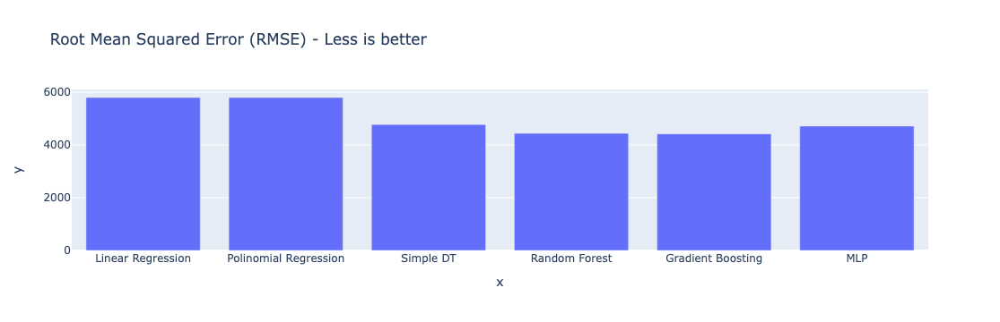

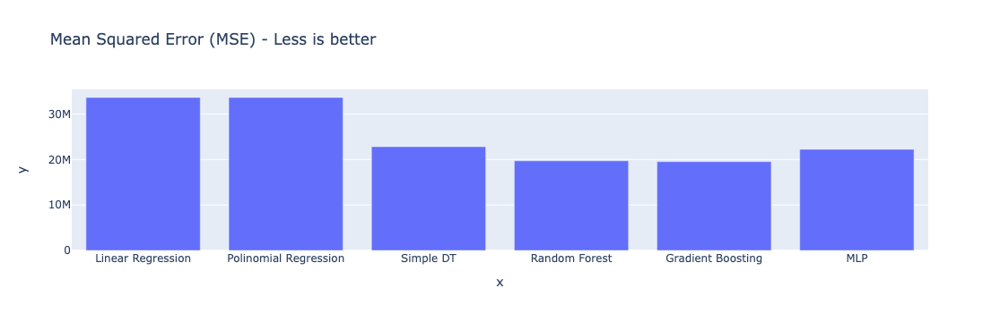

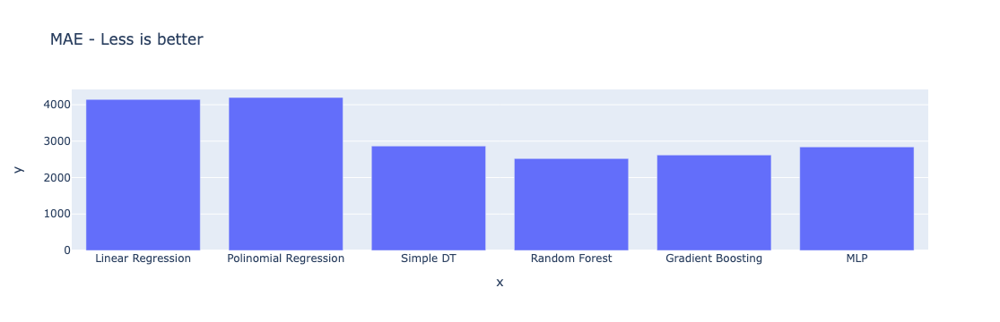

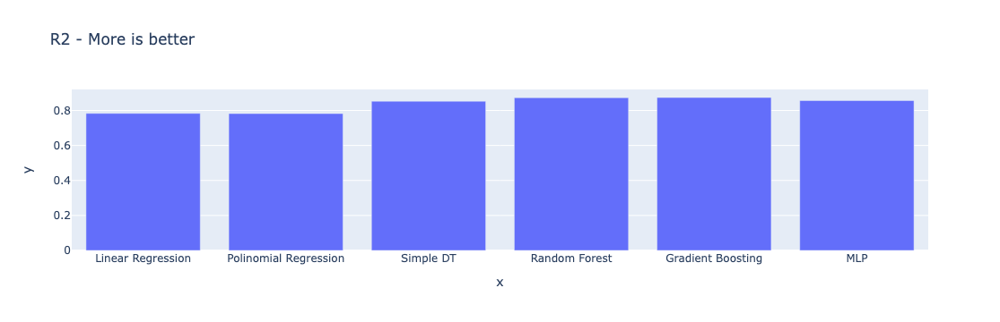

In [71]:
import plotly.express as px
    
categories = list(models.keys())

#RMSE
values = mse_sq
fig = px.bar(x=categories, y=values, title='Root Mean Squared Error (RMSE) - Less is better')
fig.show()

#MSE
categories = list(models.keys())
values = list(models.values())
fig = px.bar(x=categories, y=values, title='Mean Squared Error (MSE) - Less is better')
fig.show()

#MAE
categories = list(models.keys())
values = maes
fig = px.bar(x=categories, y=values, title='MAE - Less is better')
fig.show()

#R2
categories = list(models.keys())
values = r2
fig = px.bar(x=categories, y=values, title='R2 - More is better')
fig.show()

#### About the metric of choice

*The best performing models are the Random Forest and the Gradient Boosting Regressors. To decide between this two models, we will base our decision in the following information:**


- RMSE (Root Mean Squared Error):

> RMSE penalizes large errors more, which can be desirable in cases where larger errors are more costly or impactful.

- MAE (Mean Absolute Error):

> MAE is a more appropriate choice when you want to measure the average magnitude of errors without giving extra weight to larger errors. It's also easier to explain to non-technical stakeholders.

**In summary**

Based on this knowledge, and because of the nature of the problem when we want as much precision as possible to predict the charges (so that we can save on insurance costs and better plan for the future) we will be going for the RMSE metric. 

In [72]:
df.charges.describe()

count     1338.000000
mean     13270.422265
std      12110.011237
min       1121.873900
25%       4740.287150
50%       9382.033000
75%      16639.912515
max      63770.428010
Name: charges, dtype: float64

In [73]:
np.sqrt(12110)

110.04544515789829

## 8) Conclusions

> The best performing model on the current data is the Gradient Boosting Regressor. Note the error values achieved for our business problem context are still pretty high.

> Even though the RMSE of the winner model is still smaller than the STD deviation of the variable we want to predict, the performance of the model could still be better. 

> To improve the performance of the models, we could take some more time to perform better hyperparameter tunning (with more compute power and even more variations on the hyperparam values)

> We could also gather more data: The dataset is relatively small, so one viable approach could be to try to get more information on the phenomenon we want to predict for our models to be able to see more examples on it and better predict the target variable. Either by getting more training examples (to reduce high variance) or by adding additional features or exploring some Feature Engineering to generate new information from the existing ones (to reduce high bias). See the training curves for the two best models bellow, where a high bias situation is being presented for the Gradient Boosting and a high variance situation (performance could still be improved by adding more data -> CV and Training errors would converge) for the Random Forest.

### 8.1) Extra: Evaluating the Learning Curves based on a Sklearn Implementation

We want to understand if our best models are overfitting or underfitting. High bias vs high Variance cases, to understand how we can better improve them.

In [249]:
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=None,
    ylim=None,
    cv=None,
    n_jobs=None,
    scoring=None,
    train_sizes=np.linspace(0.1, 1.0, 5),
):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    scoring : str or callable, default=None
        A str (see model evaluation documentation) or
        a scorer callable object / function with signature
        ``scorer(estimator, X, y)``.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = learning_curve(
        estimator,
        X,
        y,
        scoring=scoring,
        cv=cv,
        n_jobs=n_jobs,
        train_sizes=train_sizes,
        return_times=True,
    )
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    axes[0].fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )
    axes[0].plot(
        train_sizes, train_scores_mean, "o-", color="r", label="Training score"
    )
    axes[0].plot(
        train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score"
    )
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, "o-")
    axes[1].fill_between(
        train_sizes,
        fit_times_mean - fit_times_std,
        fit_times_mean + fit_times_std,
        alpha=0.1,
    )
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    fit_time_argsort = fit_times_mean.argsort()
    fit_time_sorted = fit_times_mean[fit_time_argsort]
    test_scores_mean_sorted = test_scores_mean[fit_time_argsort]
    test_scores_std_sorted = test_scores_std[fit_time_argsort]
    axes[2].grid()
    axes[2].plot(fit_time_sorted, test_scores_mean_sorted, "o-")
    axes[2].fill_between(
        fit_time_sorted,
        test_scores_mean_sorted - test_scores_std_sorted,
        test_scores_mean_sorted + test_scores_std_sorted,
        alpha=0.1,
    )
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt


In [ ]:
import sklearn.metrics as met
met.get_scorer_names()

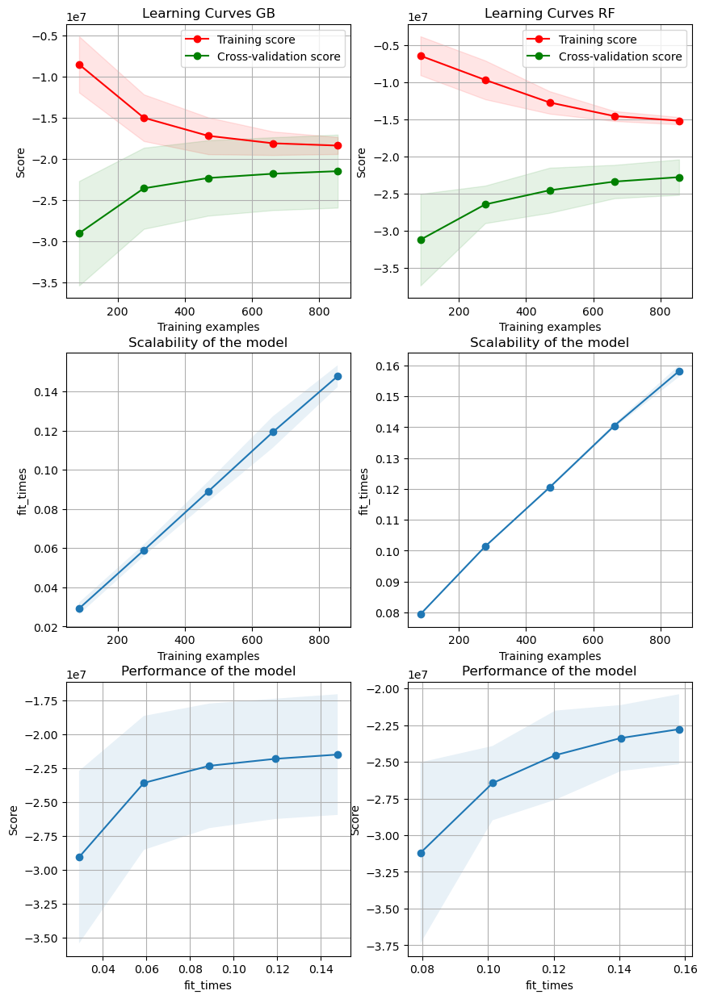

In [256]:
fig, axes = plt.subplots(3, 2, figsize=(10, 15))

X, y = X_train, y_train

title = "Learning Curves GB"
# Cross validation with 50 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=50, test_size=0.2, random_state=0)

estimator = best_gb

plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=axes[:, 0],
    cv=cv,
    n_jobs=4,
    scoring="neg_mean_squared_error",
)

title = r"Learning Curves RF"

cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

estimator = best_rf_regressor
plot_learning_curve(
    estimator, title, X, y, axes=axes[:, 1], cv=cv, n_jobs=4,scoring="neg_mean_squared_error",

)

plt.show()

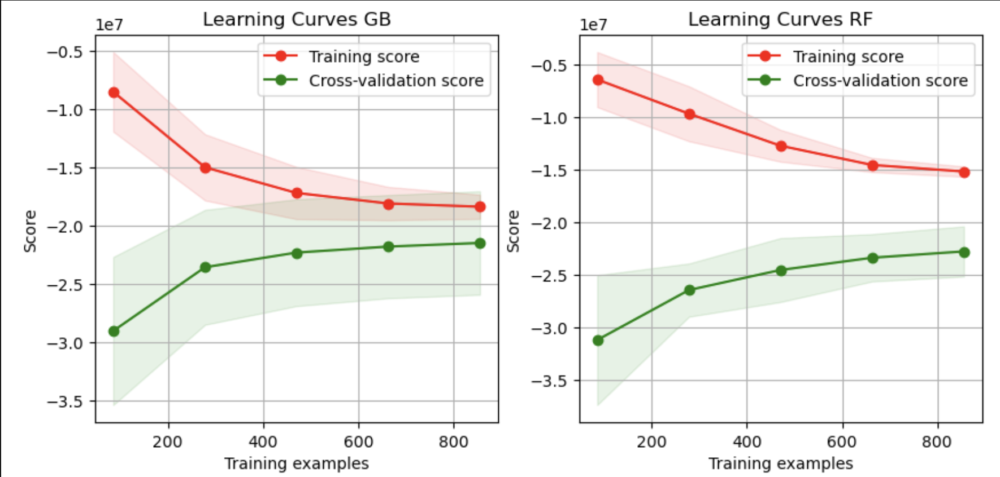

### 8.2) Extra: Save model results on a txtfile for production implementation

In [74]:
model_names = list(models.keys())

In [75]:
MSES = list(models.values())

In [76]:
RMSES = mse_sq

In [77]:
maes

[4146.085908627523,
 4198.639934520427,
 2865.6378101751243,
 2521.701914584406,
 2618.202322992361,
 2840.596265785886]

In [78]:
r2

[0.783304578326764,
 0.7822984675967947,
 0.8530572866320028,
 0.8730223752691371,
 0.8741872253876677,
 0.8567701851854502]

In [79]:
from datetime import date

filename = f'training_output - {date.today()}.csv'

with open(filename, 'a') as file:
    file.write("model_name, MSE, RMSE, MAE, R2\n")
    for x in range(0, len(model_names)):
        line = str(model_names[x]) + "," + str(MSES[x])+","+ str(RMSES[x])+ "," + str(maes[x]) + "," + str(r2[x])
        file.write(line + "\n")
print(f"Lists have been saved to {filename}")

Lists have been saved to training_output - 2023-11-04.csv


### 8.3) Extra: Save the best model for production

In [80]:
import pickle

def get_best_model():
    # get best model
    index = RMSES.index(min(RMSES))
    best_model_name = model_names[index]
    print(f"\n > Best model is {best_model_name} 🧠\n")
    return model_instances[index]

def save_model(best):
    with open('best_model.pkl', 'wb') as file:
        print(f"\n > Exporting best model to pkl file 🧠\n")

        pickle.dump(best, file)

def load_model():
    with open('model.pkl', 'rb') as file:
        loaded_model = pickle.load(file)
        return loaded_model

In [81]:
get_best_model()


 > Best model is Gradient Boosting 🧠



GradientBoostingRegressor(learning_rate=0.01, n_estimators=300)

In [82]:
best = get_best_model()
save_model(best)


 > Best model is Gradient Boosting 🧠


 > Exporting best model to pkl file 🧠

